nbviewer.jupyter.org/format/slides/gist/leechanwoo/

In [1]:
from IPython.display import Image

# Deep Learning Day 2.

## Scenario 1. FFNN (Binary)
 * Dataset
 * Reading Dataset File
 * Building Model
 * Model Save/Restore
 * Tensorboard

### Dataset

|label|data0|data1|data2|data3|data4|data5|data6|data7|data8|data9|
|:-:|:-:|:-:|:-:|:-:|:-:|:-:|:-:|:-:|:-:|:-:|:-:|
|0|0|1|2|3|4|5|6|7|8|9|
|1|9|8|7|6|5|4|3|2|1|0|
|0|0|1|2|3|4|5|6|7|8|9|
|1|9|8|7|6|5|4|3|2|1|0|
|0|0|1|2|3|4|5|6|7|8|9|
|1|9|8|7|6|5|4|3|2|1|0|

### Reading Dataset File

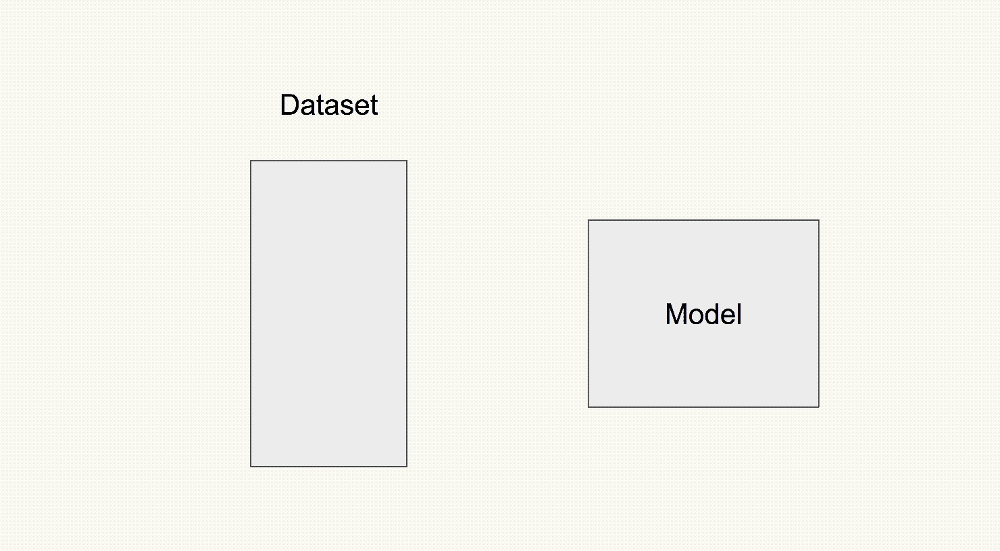

In [2]:
Image('./day2/pipeline.gif.png')

### Building Model

 * Feed Forward Neural Network(FFNN)
 * Neural Network 모델 중 가장 기본적인 모델


$$ y_0 = w_{00}x_0 + w_{01}x_1 + w_{02}x_2 + w_{03}x_3 ... w_{0n}x_n $$
$$ y_1 = w_{10}x_0 + w_{11}x_1 + w_{12}x_2 + w_{13}x_3 ... w_{1n}x_n $$
$$ y_2 = w_{20}w_0 + w_{21}x_1 + w_{22}x_2 + w_{23}x_3 ... w_{2n}x_n $$
$$ y_3 = w_{30}w_0 + w_{31}x_1 + w_{32}x_2 + w_{33}x_3 ... w_{3n}x_n $$
$$...$$
$$ y_m = w_{m0}x_0 + w_{m1}x_1 + w_{m2}x_2 + w_{m3}x_3 ... w_{mn}x_n $$


$$ \begin{bmatrix} y_0\\y_1\\y_2\\y_3\\...\\y_m \end{bmatrix} = \begin{bmatrix} w_{00}&w_{01}&w_{02}&w_{03}&...&w_{0n} \\ w_{10}&w_{11}&w_{12}&w_{13}&...&w_{1n} \\ w_{20}&w_{21}&w_{22}&w_{23}&...&w_{2n} \\ w_{30}&w_{31}&w_{32}&w_{33}&...&w_{3n} \\ ...&...&...&...&...&... \\ w_{m0}&w_{m1}&w_{m2}&w_{m3}&...&w_{mn} \end{bmatrix} \begin{bmatrix} x_0\\x_1\\x_2\\x_3\\...\\x_n \end{bmatrix} $$

$$ Y^{(1)} = W_1^TX \cdots 1\ layer$$ 

$$ Y^{(2)} = W_2^TY^{(1)} \cdots 2\ layer $$

$$ Y^{(3)} = W_3^TY^{(2)} \cdots 3\ layer $$

 * Neural Net 내부의 Layer는 hidden layer라고 부른다.
 * 각 hidden layer에는 activation function을 취해준다.
 * 여기서는 sigmoid function을 activation function으로 사용
 
$$ \sigma(x) = \frac{1}{1 + e^{-(wx + b)}} $$ <br>

$$ h = \sigma(W^TX) $$

$$ h^{(1)} = \sigma(W_1^TX) \cdots 1\ layer$$ <br>
$$ h^{(2)} = \sigma(W_2^Th^{(1)}) \cdots 2\ layer $$ <br>
$$ h^{(3)} = \sigma(W_3^Th^{(2)}) \cdots 3\ layer $$ <br>
$$ Y = \sigma(W_o^Th^{(3)}) \cdots output\ layer $$ <br>

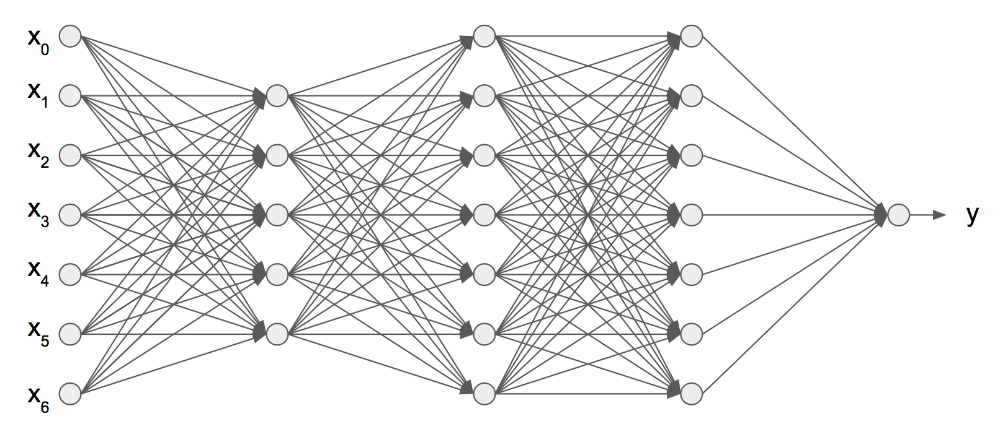

In [3]:
Image('./day2/nerual_network_bin.png')

### Model save/restore

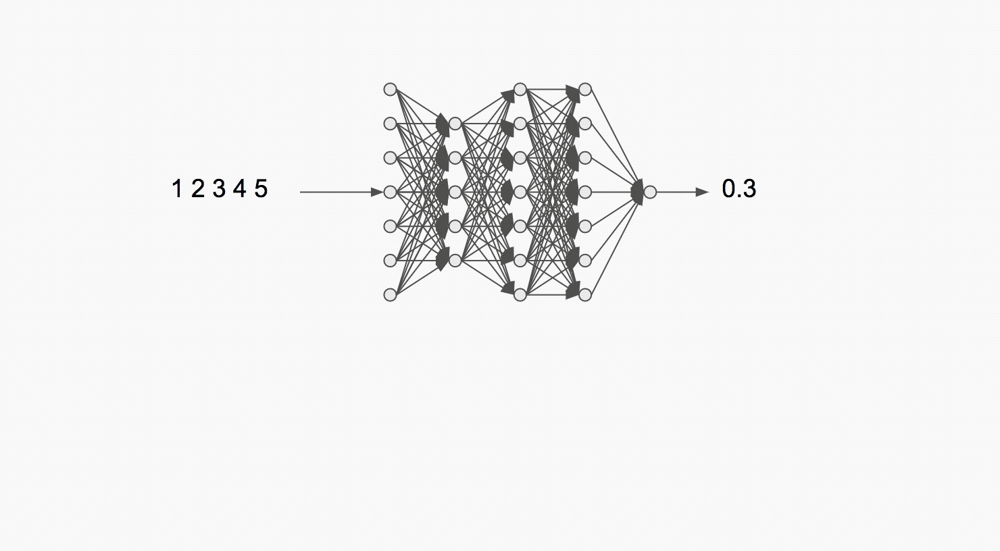

In [4]:
Image('./day2/saver.gif.png')

### Implementation

In [5]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import csv

In [6]:
samples = 1000
test_samples = 100
train_dataset = './ffnn_dataset/train_dataset.csv'
test_dataset = './ffnn_dataset/test_dataset.csv'

def write_dataset(samples, test_samples, train_dir, test_dir):
    up = [i for i in range(10)]
    down = [9-i for i in range(10)]

    data = []
    label = []
    for i in range(samples):
        data.append(up)
        data.append(down)
        label.append([1])
        label.append([0])

    with open(train_dataset, 'w') as csvfile:
        writer = csv.writer(csvfile)
        for i in range(samples-test_samples):
            writer.writerow(label[i] + data[i])
        print('train data is written')

    with open(test_dataset, 'w') as csvfile:
        writer = csv.writer(csvfile)
        for i in range(test_samples):
            writer.writerow(label[i] + data[i])
        print('test data is written')
        
write_dataset(1000, 100, train_dataset, test_dataset)

train data is written
test data is written


In [7]:
tf.reset_default_graph()
trainset = tf.contrib.data.TextLineDataset(train_dataset).batch(10)
testset = tf.contrib.data.TextLineDataset(test_dataset).batch(10)

train_itr = trainset.make_one_shot_iterator()
test_itr = testset.make_one_shot_iterator()

train_batch = train_itr.get_next()
test_batch = test_itr.get_next()

train_batch = tf.decode_csv(train_batch, [[0]]*11)
test_batch = tf.decode_csv(test_batch, [[0]]*11)

y_ = tf.reshape(train_batch[0], [-1, 1])
test_label = tf.reshape(test_batch[0], [-1, 1])

x = tf.stack(train_batch[1:], axis=1)
test_data = tf.stack(test_batch[1:], axis=1)

test_label = tf.cast(test_label, tf.float32)
test_input = tf.cast(test_data, tf.float32)
y_ = tf.cast(y_, tf.float32)
x = tf.cast(x, tf.float32)

print(y_)
print(x)
print(test_label)
print(test_input)

Tensor("Cast_2:0", shape=(?, 1), dtype=float32)
Tensor("Cast_3:0", shape=(?, 10), dtype=float32)
Tensor("Cast:0", shape=(?, 1), dtype=float32)
Tensor("Cast_1:0", shape=(?, 10), dtype=float32)


In [8]:
def bin_model(x, activation, reuse=False):
    layer1 = tf.layers.dense(x, 10, activation=activation, reuse=reuse, name='layer1')
    layer2 = tf.layers.dense(layer1, 10, activation=activation, reuse=reuse, name='layer2')
    layer3 = tf.layers.dense(layer2, 10, activation=activation, reuse=reuse, name='layer3')
    layer4 = tf.layers.dense(layer3, 10, activation=activation, reuse=reuse, name='layer4')
    return tf.layers.dense(layer4, 1, activation=activation, reuse=reuse, name='layer_out')


train_out = bin_model(x, tf.nn.relu)
test_out = bin_model(test_input, tf.nn.relu, True)

for var in tf.trainable_variables():
    print(var)

<tf.Variable 'layer1/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'layer1/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'layer2/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'layer2/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'layer3/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'layer3/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'layer4/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'layer4/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'layer_out/kernel:0' shape=(10, 1) dtype=float32_ref>
<tf.Variable 'layer_out/bias:0' shape=(1,) dtype=float32_ref>


In [9]:
loss = tf.losses.sigmoid_cross_entropy(y_, train_out)
train_op = tf.train.GradientDescentOptimizer(1e-2).minimize(loss)

INFO:tensorflow:logits.dtype=<dtype: 'float32'>.
INFO:tensorflow:multi_class_labels.dtype=<dtype: 'float32'>.
INFO:tensorflow:losses.dtype=<dtype: 'float32'>.


In [10]:
pred = tf.nn.sigmoid(test_out)
accuracy = tf.metrics.accuracy(y_, tf.round(pred))

In [11]:
saver = tf.train.Saver()

In [12]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    sess.run(tf.local_variables_initializer())
    for i in range(10):
        while True:
            try:
                _, _loss = sess.run([train_op, loss])
                _acc = sess.run(accuracy)
            except tf.errors.OutOfRangeError:
                break
                
        print('epoch: {}, loss: {}, acc: {}'.format(i, _loss, _acc[0]))
        saver.save(sess, './logs/model')

epoch: 0, loss: 0.6931471824645996, acc: 0.5
epoch: 1, loss: 0.6931471824645996, acc: 0.5
epoch: 2, loss: 0.6931471824645996, acc: 0.5
epoch: 3, loss: 0.6931471824645996, acc: 0.5
epoch: 4, loss: 0.6931471824645996, acc: 0.5
epoch: 5, loss: 0.6931471824645996, acc: 0.5
epoch: 6, loss: 0.6931471824645996, acc: 0.5
epoch: 7, loss: 0.6931471824645996, acc: 0.5
epoch: 8, loss: 0.6931471824645996, acc: 0.5
epoch: 9, loss: 0.6931471824645996, acc: 0.5


## Scenario 2. FFNN(Multi-class)
 * Building Model

### Building Model

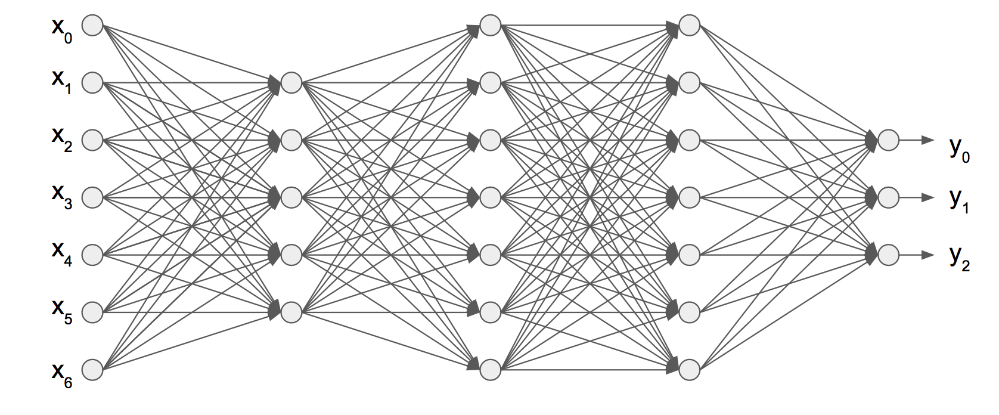

In [13]:
Image('./day2/neural_network.png')

### Implementation

In [14]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import csv

In [15]:
samples = 1000
test_samples = 100
train_dataset = './ffnn_multiclass_dataset/train_dataset.csv'
test_dataset = './ffnn_multiclass_dataset/test_dataset.csv'

up = [i for i in range(10)]
down = [9-i for i in range(10)]
flat = [5 for i in range(10)]

data = []
label = []
for i in range(samples):
    data.append(up)
    data.append(flat)
    data.append(down)
    label.append([0])
    label.append([1])
    label.append([2])
    
for i in range(10):
    print('data: {}, label {}'.format(data[i], label[i]))

    
    
with open(train_dataset, 'w') as csvfile:
    writer = csv.writer(csvfile)
    for i in range(samples-test_samples):
        writer.writerow(label[i] + data[i])
    print('train data is written')
        
with open(test_dataset, 'w') as csvfile:
    writer = csv.writer(csvfile)
    for i in range(test_samples):
        writer.writerow(label[i] + data[i])
    print('test data is written')

data: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], label [0]
data: [5, 5, 5, 5, 5, 5, 5, 5, 5, 5], label [1]
data: [9, 8, 7, 6, 5, 4, 3, 2, 1, 0], label [2]
data: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], label [0]
data: [5, 5, 5, 5, 5, 5, 5, 5, 5, 5], label [1]
data: [9, 8, 7, 6, 5, 4, 3, 2, 1, 0], label [2]
data: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], label [0]
data: [5, 5, 5, 5, 5, 5, 5, 5, 5, 5], label [1]
data: [9, 8, 7, 6, 5, 4, 3, 2, 1, 0], label [2]
data: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], label [0]
train data is written
test data is written


In [16]:
tf.reset_default_graph()
trainset = tf.contrib.data.TextLineDataset(train_dataset).batch(10)
testset = tf.contrib.data.TextLineDataset(test_dataset).batch(10)

train_itr = trainset.make_one_shot_iterator()
test_itr = testset.make_one_shot_iterator()

train_batch = train_itr.get_next()
test_batch = test_itr.get_next()

decoded_train = tf.decode_csv(train_batch, [[0]]*11)
decoded_test = tf.decode_csv(test_batch, [[0]]*11)

train_label = tf.one_hot(decoded_train[0], depth=3, axis=-1, dtype=tf.float32)
test_label = tf.reshape(decoded_test[0], [-1, 1])

train_data = tf.stack(decoded_train[1:], axis=1)
test_data = tf.stack(decoded_test[1:], axis=1)

test_data = tf.cast(test_data, tf.float32)
train_data = tf.cast(train_data, tf.float32)

print(train_data)
print(test_data)
print(train_label)
print(test_label)

Tensor("Cast_1:0", shape=(?, 10), dtype=float32)
Tensor("Cast:0", shape=(?, 10), dtype=float32)
Tensor("one_hot:0", shape=(?, 3), dtype=float32)
Tensor("Reshape:0", shape=(?, 1), dtype=int32)


In [17]:
def multi_class_model(x, activation, reuse=False):
    layer1 = tf.layers.dense(x, 10, activation=activation, reuse=reuse, name='layer1')
    layer2 = tf.layers.dense(layer1, 10, activation=activation, reuse=reuse, name='layer2')
    layer3 = tf.layers.dense(layer2, 10, activation=activation, reuse=reuse, name='layer3')
    layer4 = tf.layers.dense(layer3, 10, activation=activation, reuse=reuse, name='layer4')
    return tf.layers.dense(layer4, 3, activation=activation, reuse=reuse, name='layer_out')

train_out = multi_class_model(train_data, tf.nn.sigmoid)
test_out = multi_class_model(test_data, tf.nn.sigmoid, True)

for var in tf.trainable_variables():
    print(var)

<tf.Variable 'layer1/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'layer1/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'layer2/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'layer2/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'layer3/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'layer3/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'layer4/kernel:0' shape=(10, 10) dtype=float32_ref>
<tf.Variable 'layer4/bias:0' shape=(10,) dtype=float32_ref>
<tf.Variable 'layer_out/kernel:0' shape=(10, 3) dtype=float32_ref>
<tf.Variable 'layer_out/bias:0' shape=(3,) dtype=float32_ref>


In [18]:
loss = tf.losses.softmax_cross_entropy(train_label, train_out)
train_op = tf.train.GradientDescentOptimizer(1e-6).minimize(loss)

In [19]:
pred = tf.nn.softmax(test_out)
accuracy = tf.metrics.accuracy(test_label, tf.argmax(pred, axis=1))

In [20]:
saver = tf.train.Saver()

In [21]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    sess.run(tf.local_variables_initializer())
    for i in range(10):
        while True:
            try:
                _, _loss = sess.run([train_op, loss])
                _acc = sess.run(accuracy)
            except tf.errors.OutOfRangeError:
                break
                
        print('epoch: {}, loss: {}, acc: {}'.format(i, _loss, _acc[0]))
        saver.save(sess, './logs/model')

epoch: 0, loss: 1.0996873378753662, acc: 0.3333333432674408
epoch: 1, loss: 1.1138309240341187, acc: 0.3333333432674408
epoch: 2, loss: 1.093437910079956, acc: 0.3333333432674408
epoch: 3, loss: 1.0996873378753662, acc: 0.3333333432674408
epoch: 4, loss: 1.1138311624526978, acc: 0.3333333432674408
epoch: 5, loss: 1.093437910079956, acc: 0.3333333432674408
epoch: 6, loss: 1.0996873378753662, acc: 0.3333333432674408
epoch: 7, loss: 1.1138309240341187, acc: 0.3333333432674408
epoch: 8, loss: 1.093437910079956, acc: 0.3333333432674408
epoch: 9, loss: 1.0996873378753662, acc: 0.3333333432674408
